# Raster Data Operations
Raster data is an imporant format of spatial data. In this tutorial, we are going to using Python to manipulate the raster data format. We will work with `RasterIO` and `Numpy` for the raster data processing. RasterIO is a modern library to work with geospatial data in a gridded format. It excels at providing an easy way to read/write raster data and access individual bands and pixels as numpy arrays.

`Rasterio` is built on top of the popular `GDAL` (Geospatial Data Abstraction Library). GDAL is written in C++ so the Python API provided by GDAL is not very intuitive for Python users. RaserIO aims to make it easy for Python users to use the underlying GDAL library in an intuitive way.

In this section, we will read and write raster data using `rasterio`.

## Prepare the Python modules

In [1]:
import os, os.path
import numpy as np
import rasterio as rio
import rasterio
from rasterio.plot import show
from rasterio.mask import mask
from rasterio.windows import get_data_window
from rasterio.windows import Window
from rasterio.merge import merge
# optional - turn off warnings
import warnings
from matplotlib import pyplot as plt
warnings.filterwarnings('ignore')

## Read the raster data and get the metadata of the raster data

In [2]:
naip_file = 'chicago-naip/il_m_4208758_sw_16_060_20190809_20191221.tif'
naip_dataset = rio.open(naip_file)
naip_bounds = naip_dataset.bounds
naip_bounds

BoundingBox(left=427234.8, bottom=4649794.8, right=433118.39999999997, top=4657441.2)

In [3]:
naip_dataset.crs

CRS.from_epsg(26916)

In [4]:
naip_dataset.meta

{'driver': 'GTiff',
 'dtype': 'uint8',
 'nodata': None,
 'width': 9806,
 'height': 12744,
 'count': 4,
 'crs': CRS.from_epsg(26916),
 'transform': Affine(0.6, 0.0, 427234.8,
        0.0, -0.6, 4657441.2)}

## Read the geotiff image for different bands

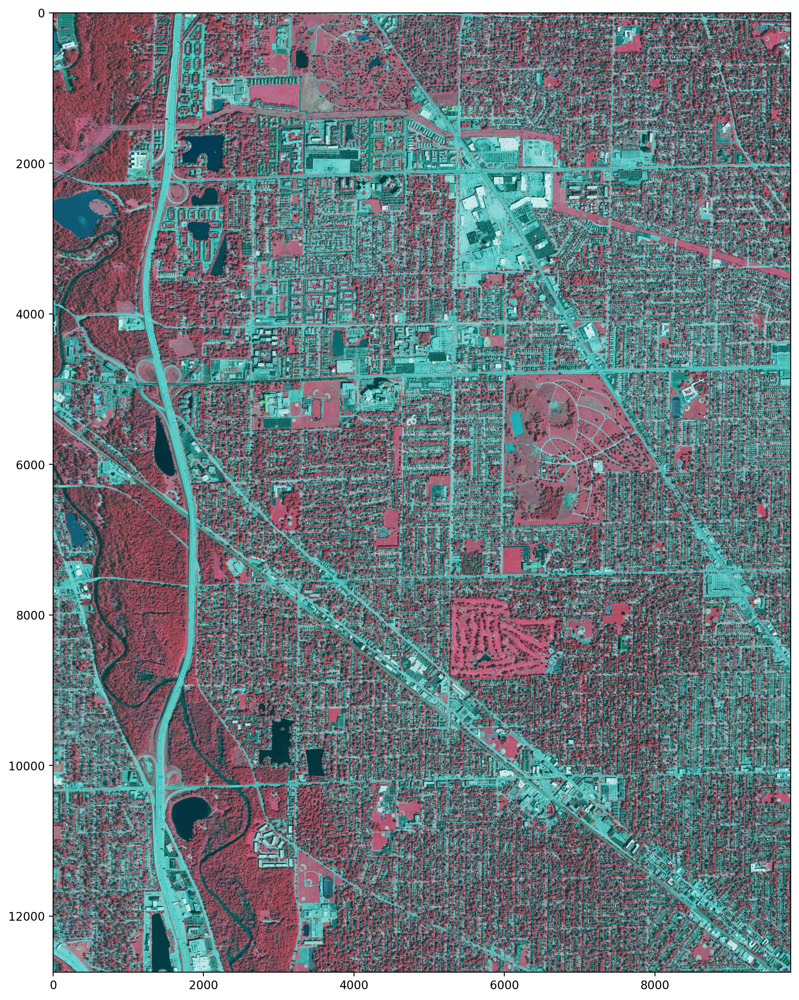

In [5]:
import numpy as np
from matplotlib import pyplot as plt

naip_file = 'chicago-naip/il_m_4208758_sw_16_060_20190809_20191221.tif'
naip_dataset = rio.open(naip_file)

# read the different bands of the raster data
nir = np.float32(naip_dataset.read(4))
blue = np.float32(naip_dataset.read(3))
green = np.float32(naip_dataset.read(2))
red = np.float32(naip_dataset.read(1))


# stack different layer images
cir = np.dstack((nir,red,green))


# plt.imshow(band1)
plt.figure(figsize=(15, 15), dpi=200)
plt.imshow(cir.astype(np.uint8))

## Display the NAIP image

Resampling to 6372,4903


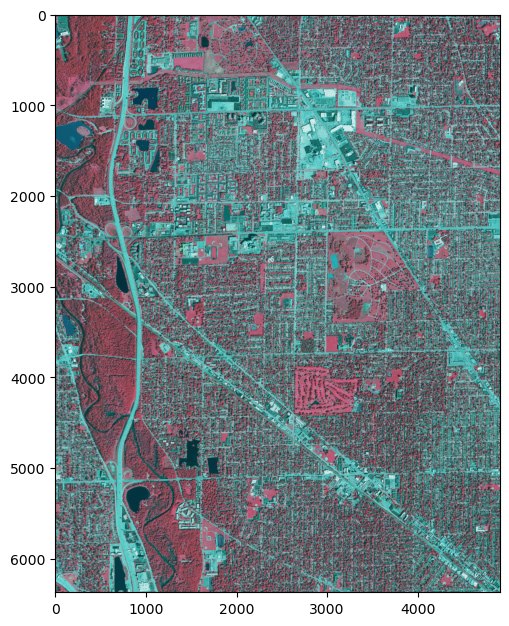

In [6]:
def display_naip_tile(filename, dsfactor = 2):
    """
    Display a NAIP tile using rasterio.
    
    dsfactor: downsample factor
    For .mrf-formatted tiles (which span multiple files), 'filename' should refer to the 
    .mrf file.
    """
    
    # NAIP tiles are enormous; downsize for plotting in this notebook
    
    with rasterio.open(filename) as raster:
        # rasterio uses 1-based indexing for channels.
        h = int(raster.height/dsfactor)
        w = int(raster.width/dsfactor)
        print('Resampling to {},{}'.format(h,w))
        ir = raster.read(4, out_shape=(1, h, w))
        r = raster.read(1, out_shape=(1, h, w))
        g = raster.read(2, out_shape=(1, h, w))
        
    cir = np.dstack((ir,r,g))
    fig = plt.figure(figsize=(7.5, 7.5), dpi=100, edgecolor='k')
    plt.imshow(cir)
    raster.close()
    
naip_file = 'chicago-naip/il_m_4208758_sw_16_060_20190809_20191221.tif'
display_naip_tile(naip_file)

## Calculate the NDVI from NAIP image

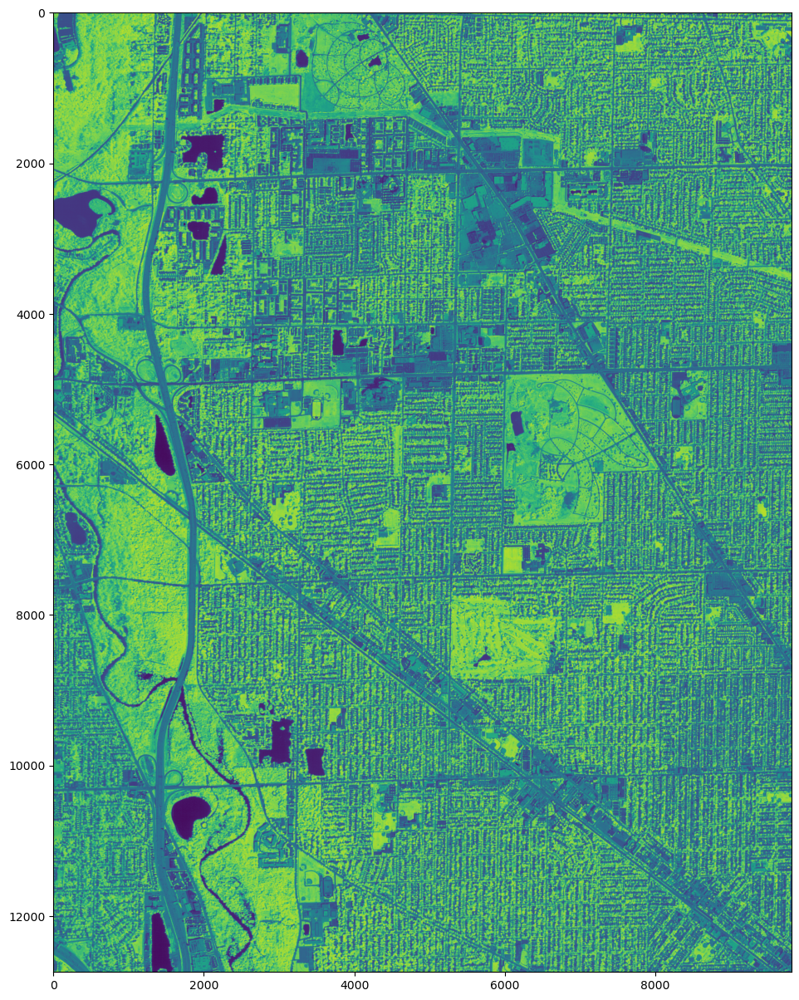

In [7]:
# here add 0.0000001 is to make sure the nir+red is not zero
ndvi = (nir - red)/(nir + red + 0.000001)

plt.figure(figsize=(15, 15))
plt.imshow(ndvi)

In [8]:
ndvi.shape

(12744, 9806)

In [9]:
# check the statistics of the calcualted NDVI images
ndvi.max()

0.6040609

## Extract vegetation from NAIP image

In [10]:
ndvi > 0

array([[ True,  True,  True, ...,  True, False, False],
       [ True,  True,  True, ...,  True,  True, False],
       [ True,  True,  True, ...,  True,  True,  True],
       ...,
       [False, False, False, ...,  True,  True, False],
       [False, False, False, ...,  True,  True, False],
       [False, False, False, ...,  True,  True, False]])

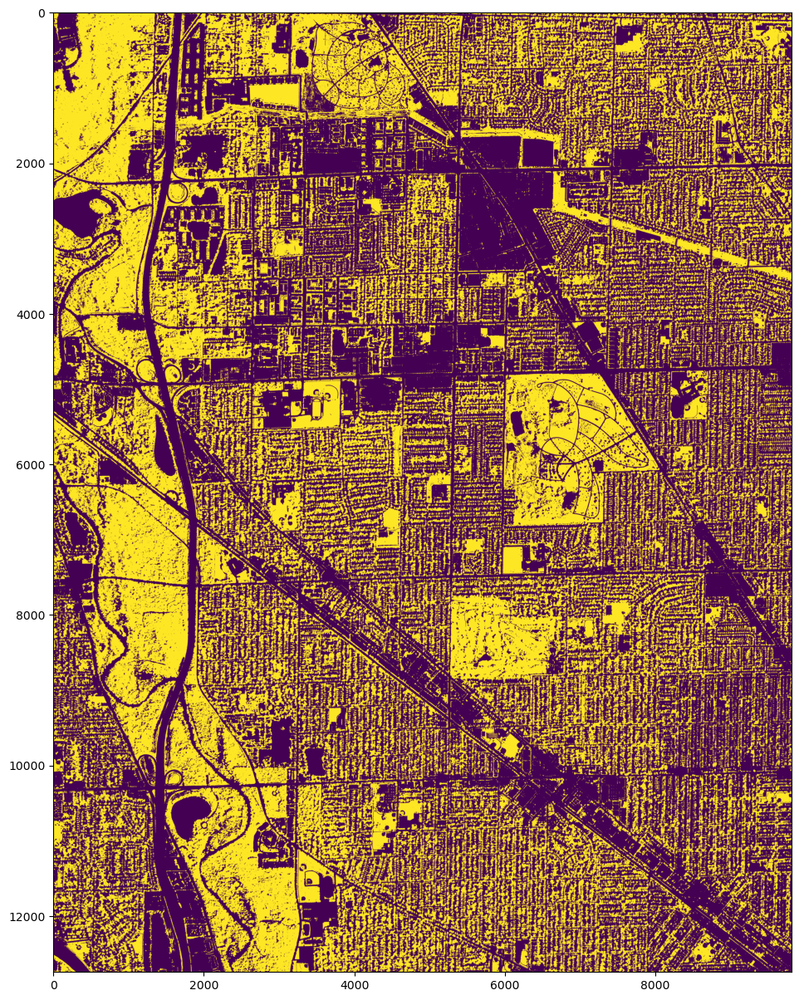

In [11]:
plt.figure(figsize=(15, 15))
# vegetation = 1
veg = np.zeros((ndvi.shape[0], ndvi.shape[1]), dtype = np.uint16)
veg[ndvi > 0] = 1

plt.imshow(veg)

## Save raster data as a new tiff file

In [12]:
# output name
out_tif = 'data/chicago-veg.tif'

# prepare the schema of the new tiles
out_meta = naip_dataset.meta.copy()
out_meta

{'driver': 'GTiff',
 'dtype': 'uint8',
 'nodata': None,
 'width': 9806,
 'height': 12744,
 'count': 4,
 'crs': CRS.from_epsg(26916),
 'transform': Affine(0.6, 0.0, 427234.8,
        0.0, -0.6, 4657441.2)}

In [13]:
veg.shape

(12744, 9806)

In [14]:
# output name
out_tif = 'data/chicago-veg.tif'

# prepare the schema of the new tiles
out_meta = naip_dataset.meta.copy()

# update the schema of the ndvi image, because it is different from teh raw naip image, like only one band
out_meta.update({'count': 1,
                # 'dtype': 'uint16',
                #  "height": ndvi.shape[0],
                #  "width": ndvi.shape[1],
#                  "transform": out_transform,
                #  "crs": naip_dataset.crs, 
                 'compress': 'lzw'}
               )

# this is required, because rio will use three dimension (Channel, Height, Width), even this is single band image
veg = veg.reshape(1, veg.shape[0], veg.shape[1])

with rio.open(out_tif, "w", **out_meta) as dest:
    dest.write(veg)

In [15]:
veg.shape

(1, 12744, 9806)